<a href="https://colab.research.google.com/github/saigulayagari/SG-FinalExam/blob/main/SG_Finalexam_OPM6000.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0.1 Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


# 0.2 Import Libraries

In [ ]:
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.holtwinters import SimpleExpSmoothing, ExponentialSmoothing
from prophet import Prophet
from datetime import timedelta


# Task 1: Data Loading and Transformation

## 1.1 Load Data

In [ ]:
file_path = '/content/drive/MyDrive/OPM6000/Finalexam'
file_names = [
    "Tomatoes.csv", "Sorghum.csv", "Potatoes (Irish).csv", "Peas (fresh).csv",
    "Oranges (big size).csv", "Maize.csv", "Chili (red).csv", "Cassava.csv", "Beans (dry).csv"
]
dataframes = [pd.read_csv(os.path.join(file_path, file)) for file in file_names]


## 1.2 Consolidate Date Column

In [ ]:
def consolidate_date(df):
    df['mp_month'] = df['mp_month'].astype(str).str.zfill(2)
    df['mp_year'] = df['mp_year'].astype(str)
    df['Date'] = pd.to_datetime(df['mp_year'] + '-' + df['mp_month'], format='%Y-%m')
    df.drop(['mp_year', 'mp_month'], axis=1, inplace=True)
    return df

dataframes = [consolidate_date(df) for df in dataframes]


## 1.3 Create Combined "Good" Column

In [ ]:
def add_combined_column(df):
    df['good'] = df['mkt_name'] + '_' + df['cm_name']
    return df

dataframes = [add_combined_column(df) for df in dataframes]


## 1.4 Combine All DataFrames

In [ ]:
combined_df = pd.concat(dataframes)
combined_df = combined_df.pivot(index='Date', columns='good', values='mp_price')


# Task 2: Data Analysis

## 2.1 Data Overview

In [ ]:
print(combined_df.shape)
print(combined_df.info())
print(combined_df.dtypes)


(96, 528)
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 96 entries, 2008-01-01 to 2015-12-01
Columns: 528 entries, Base_Beans (dry) to Rwamagana_Tomatoes
dtypes: float64(528)
memory usage: 396.8 KB
None
good
Base_Beans (dry)                float64
Base_Cassava                    float64
Base_Chili (red)                float64
Base_Maize                      float64
Base_Oranges (big size)         float64
                                 ...   
Rwamagana_Oranges (big size)    float64
Rwamagana_Peas (fresh)          float64
Rwamagana_Potatoes (Irish)      float64
Rwamagana_Sorghum               float64
Rwamagana_Tomatoes              float64
Length: 528, dtype: object


## 2.2 Check Date Continuity

In [ ]:
def check_date_continuity(df):
    date_range = pd.date_range(start=df.index.min(), end=df.index.max(), freq='MS')
    missing_dates = date_range.difference(df.index)
    return missing_dates

missing_dates = check_date_continuity(combined_df)
print("Missing Dates:", missing_dates)


## 2.3 Missing Values Summary

In [ ]:
missing_percentage = combined_df.isnull().sum() * 100 / len(combined_df)
print("Missing Values (%):", missing_percentage)


Missing Values (%): good
Base_Beans (dry)                 3.125000
Base_Cassava                    60.416667
Base_Chili (red)                62.500000
Base_Maize                       3.125000
Base_Oranges (big size)         63.541667
                                  ...    
Rwamagana_Oranges (big size)    79.166667
Rwamagana_Peas (fresh)          65.625000
Rwamagana_Potatoes (Irish)      53.125000
Rwamagana_Sorghum               52.083333
Rwamagana_Tomatoes              79.166667
Length: 528, dtype: float64


## 2.4 Summary Statistics

In [ ]:
summary_stats = combined_df.describe().loc[['mean', '50%', 'min', 'max', 'std']].rename(index={'50%': 'median'})
print(summary_stats)


good    Base_Beans (dry)  Base_Cassava  Base_Chili (red)  Base_Maize  \
mean          323.302148    228.918421        860.053242  212.002151   
median        318.500000    212.500000        787.583350  216.125000   
min           201.500000    140.000000        339.000000  115.833300   
max           514.250000    313.500000       2083.500000  316.666700   
std            70.187695     52.789826        394.814162   50.435751   

good    Base_Oranges (big size)  Base_Peas (fresh)  Base_Potatoes (Irish)  \
mean                 674.535717         797.770371             133.120835   
median               641.750000         800.000000             130.916650   
min                  350.000000         400.000000              72.500000   
max                 1000.000000        1333.000000             195.750000   
std                  110.753940         244.512881              32.822086   

good    Base_Sorghum  Base_Tomatoes  Birambo_Beans (dry)  ...  \
mean      272.867739     363.987961    

## 2.5 Time Series Visualizations

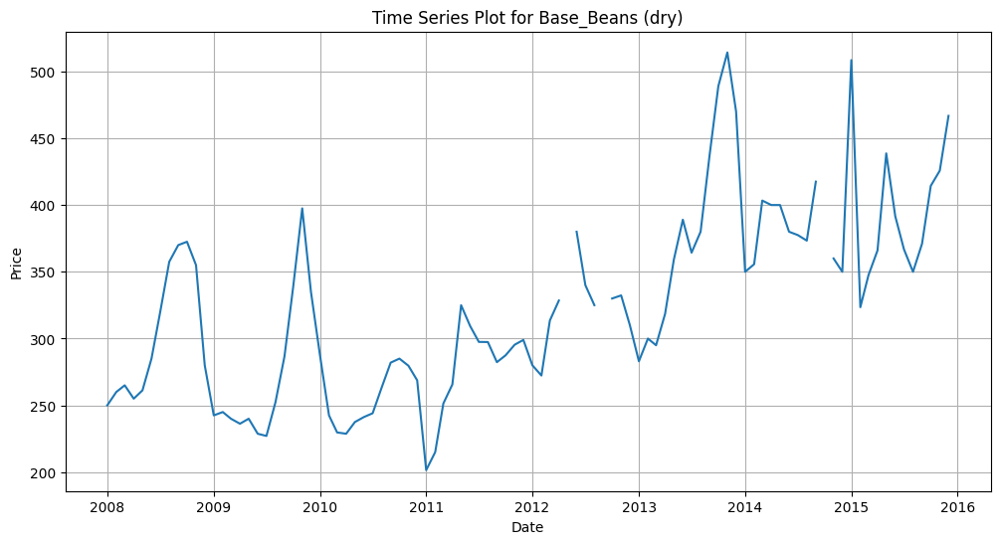

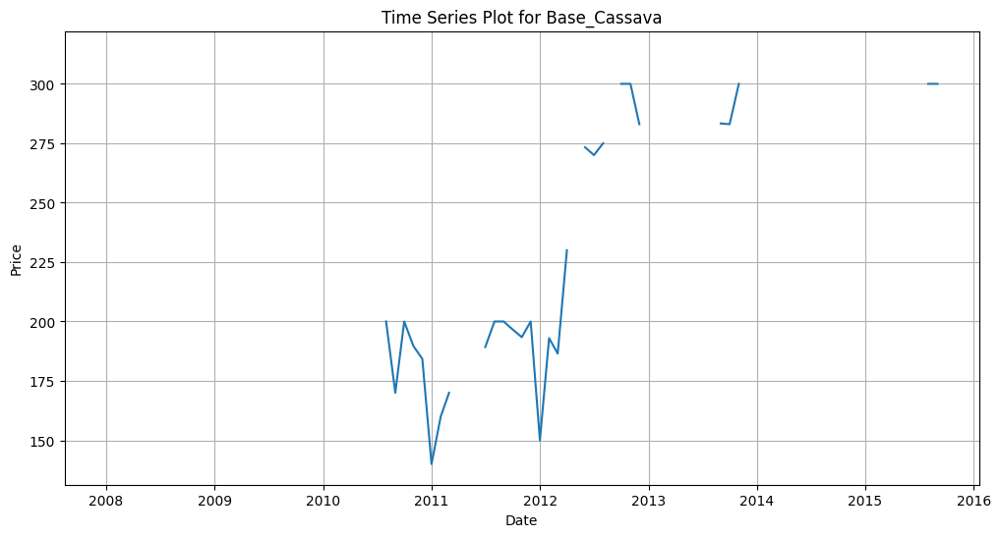

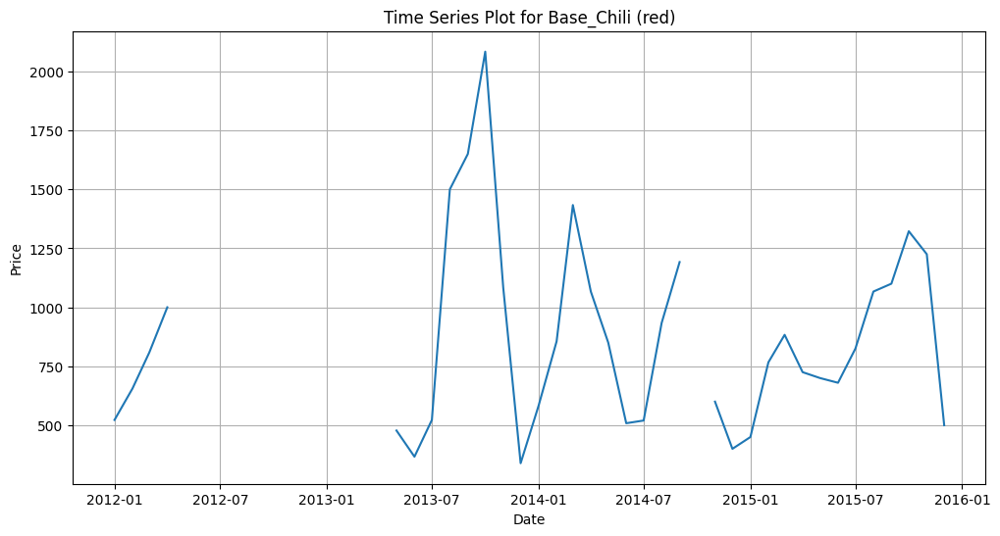

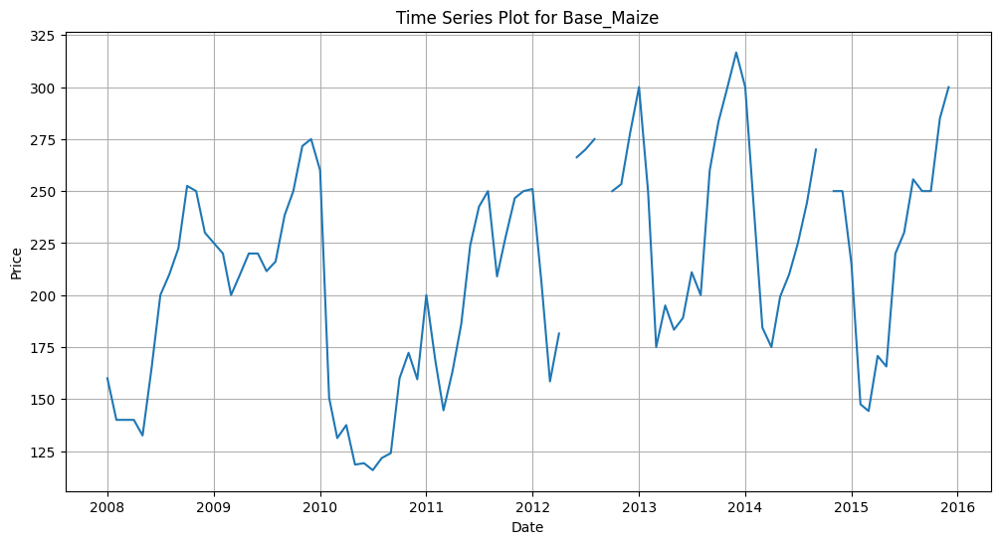

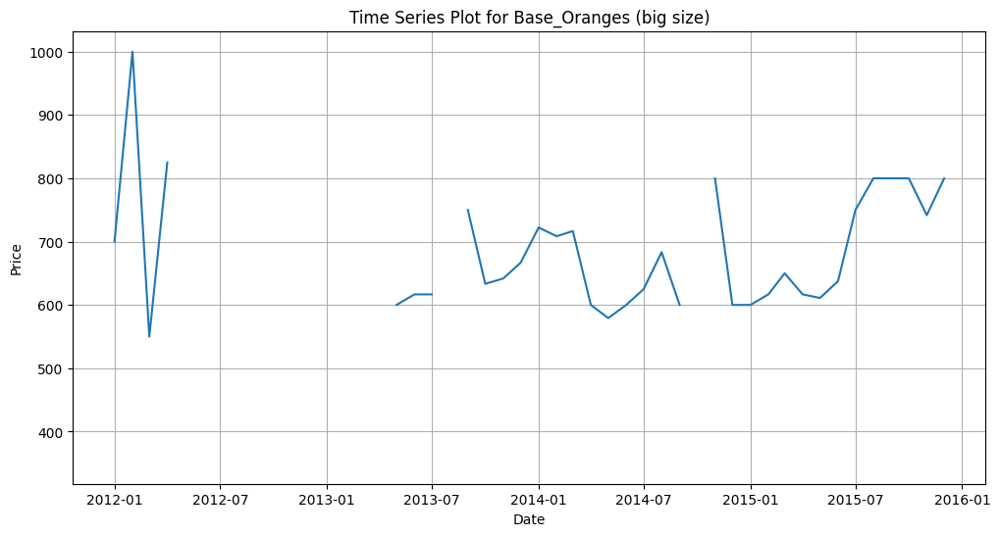

...

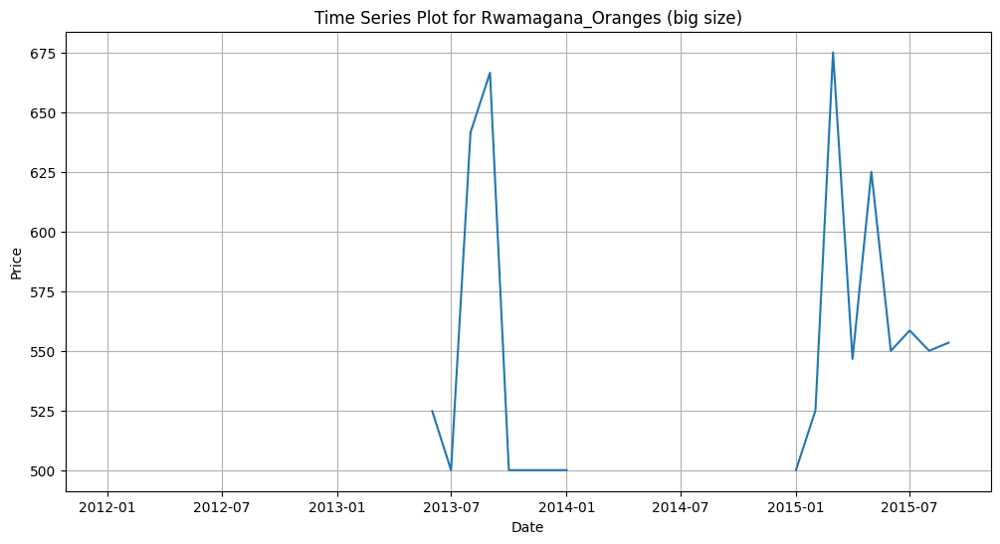

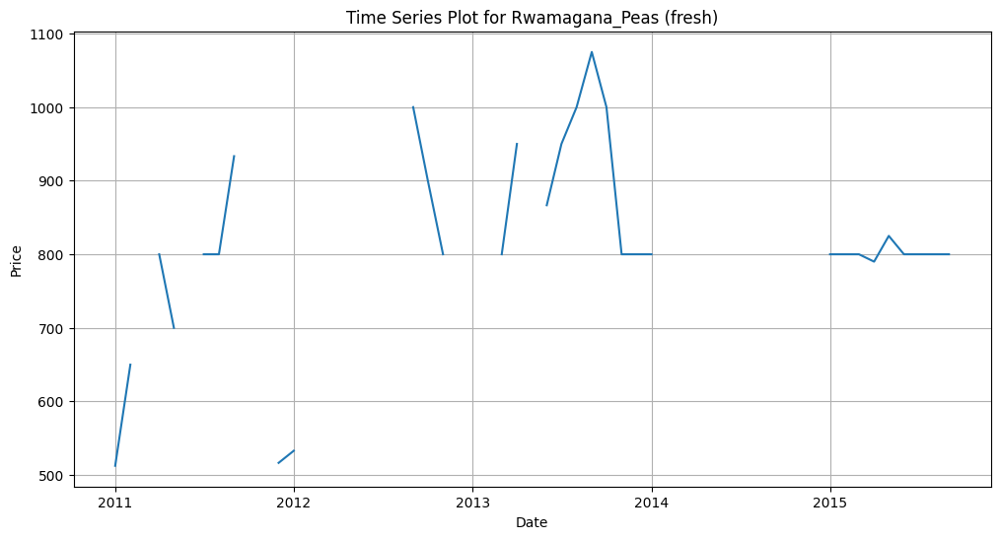

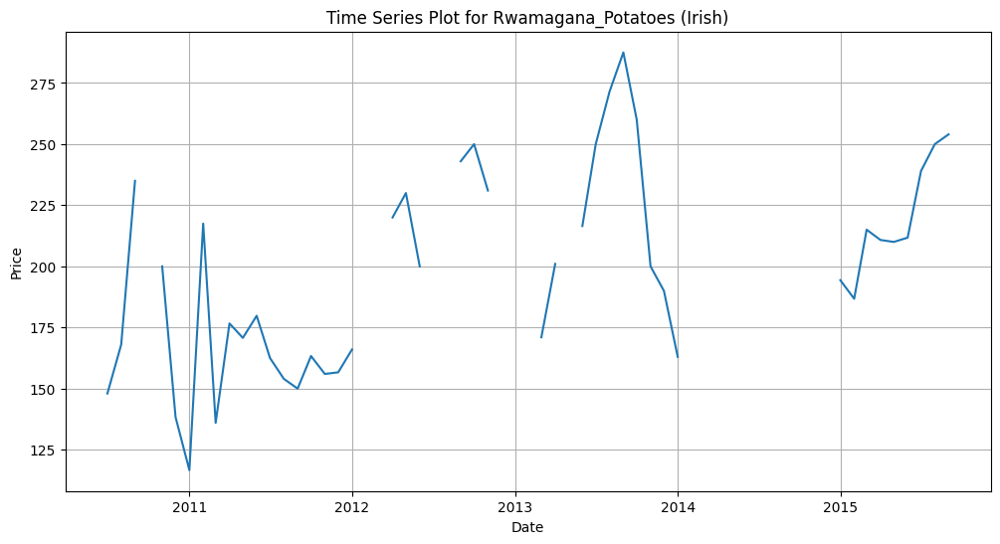

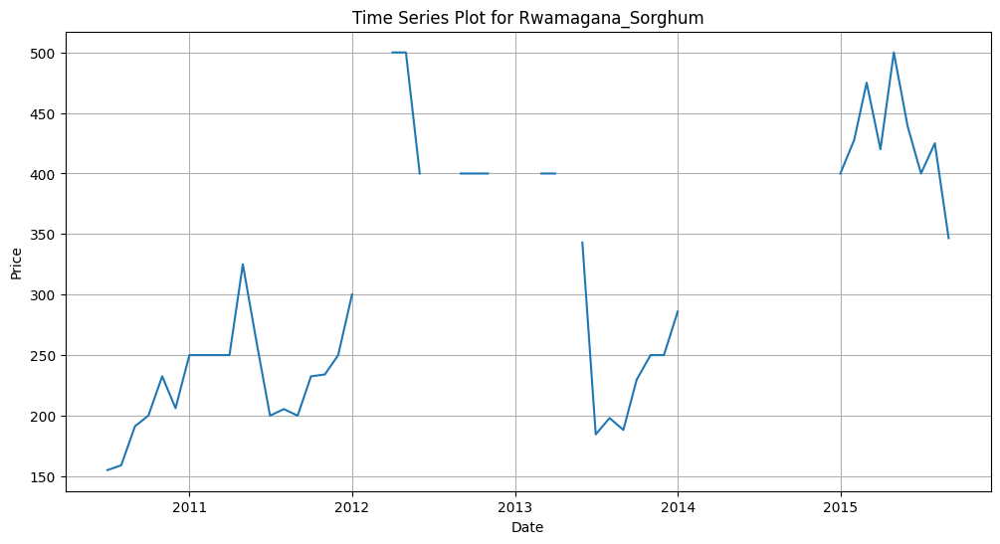

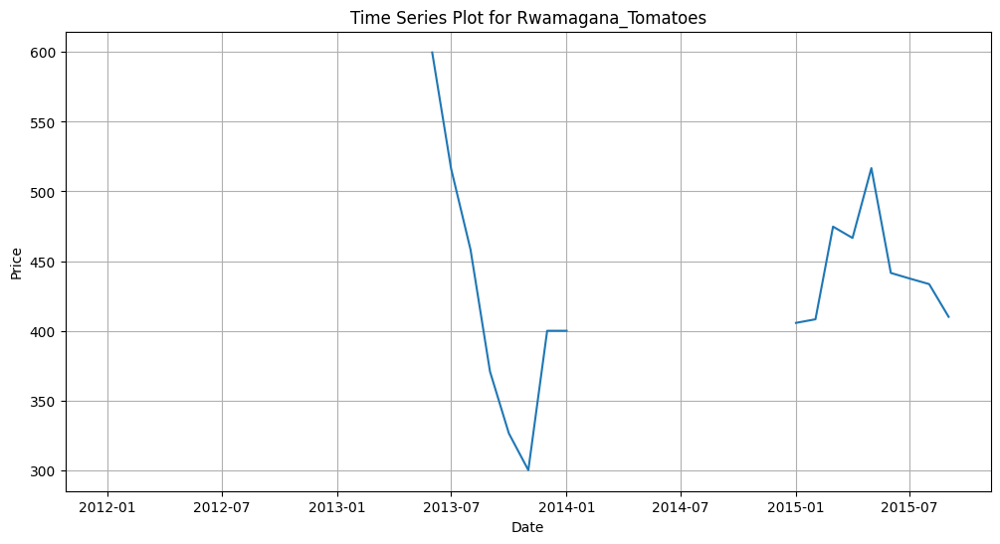

In [ ]:
for col in combined_df.columns:
    plt.figure(figsize=(12, 6))
    plt.plot(combined_df.index, combined_df[col])
    plt.title(f'Time Series Plot for {col}')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.grid(True)
    plt.show()


# Task 3: Missing Data Handling

## 3.1 Fill Missing Values Using Interpolation

In [ ]:
filled_df = combined_df.interpolate(method='linear', limit_direction='both')


# Task 4: Correlation Analysis

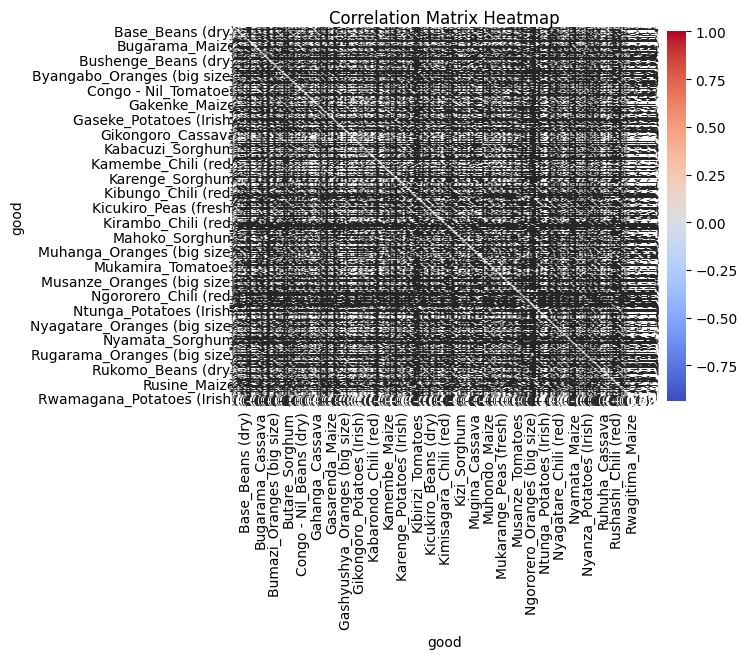

Highest Correlation: ('Gahanga_Tomatoes', 'Rwamagana_Tomatoes') -> 0.986690687170234


In [ ]:
correlation_matrix = filled_df.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix Heatmap')
plt.show()

# Find highest correlation
correlation_matrix = correlation_matrix.mask(np.eye(correlation_matrix.shape[0], dtype=bool))
max_corr = correlation_matrix.stack().idxmax()
print(f"Highest Correlation: {max_corr} -> {correlation_matrix.loc[max_corr]}")


# Task 5: Forecasting

## 5.1 Moving Averages

In [ ]:
filled_df['Tomatoes_MA_3M'] = filled_df['Rwamagana_Tomatoes'].rolling(window=3).mean()
filled_df['Tomatoes_MA_6M'] = filled_df['Rwamagana_Tomatoes'].rolling(window=6).mean()


## 5.2 ARIMA Forecasting

In [ ]:
arima_model = ARIMA(filled_df['Rwamagana_Tomatoes'], order=(5, 1, 0)).fit()
future_dates = [filled_df.index[-1] + timedelta(days=30 * i) for i in range(1, 7)]
predictions = arima_model.forecast(steps=6)


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)


## 5.3 Prophet Forecasting

In [ ]:
prophet_df = filled_df[['Rwamagana_Tomatoes']].reset_index()
prophet_df.columns = ['ds', 'y']
prophet_model = Prophet().fit(prophet_df)
future = prophet_model.make_future_dataframe(periods=6, freq='MS')
forecast = prophet_model.predict(future)


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpfqmp1oyc/o9xyxbw6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpfqmp1oyc/zvrc3wmp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63745', 'data', 'file=/tmp/tmpfqmp1oyc/o9xyxbw6.json', 'init=/tmp/tmpfqmp1oyc/zvrc3wmp.json', 'output', 'file=/tmp/tmpfqmp1oyc/prophet_modelqidswods/prophet_model-20241130155719.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
15:57:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:57:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


## 5.4 Visualization

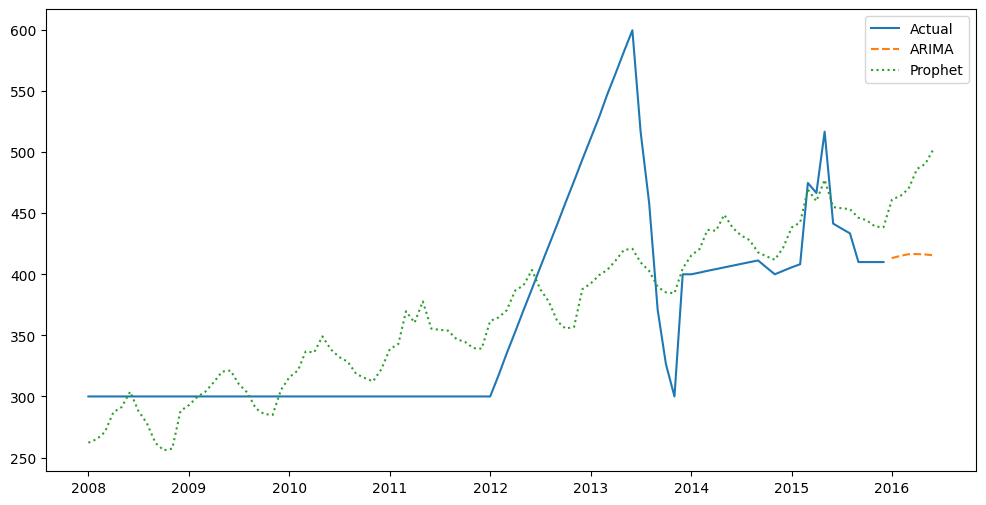

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot(filled_df['Rwamagana_Tomatoes'], label='Actual')
plt.plot(future_dates, predictions, label='ARIMA', linestyle='--')
plt.plot(forecast['ds'], forecast['yhat'], label='Prophet', linestyle=':')
plt.legend()
plt.show()
